<a href="https://colab.research.google.com/github/EDWINYAPZ/Edwin-Strengthening-fraud-detection-to-decrease-the-losses-of-the-financial-institution/blob/main/Edwin_Strengthening_fraud_detection_to_decrease_the_losses_of_the_financial_institutions_(KNN)%2C_(Linear_regression).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
#importing necessary libraries
import numpy as np
import pandas as pd
from pylab import mpl, plt
plt.style.use("seaborn")
mpl.rcParams["font.family"] = "serif"
%config InlineBackend.figure_format = "svg"
from sklearn import linear_model
import matplotlib.pyplot as plt
from sklearn.neighbors import KNeighborsClassifier
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn import neighbors
knn = neighbors.KNeighborsClassifier(n_neighbors=5)
import io
import seaborn as sns
from sklearn.preprocessing import LabelEncoder
from matplotlib import markers
from imblearn.over_sampling import SMOTE
from sklearn.datasets import make_classification
from collections import Counter
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from sklearn.metrics import r2_score

<ipython-input-1-a6e59bb547d8>:5: MatplotlibDeprecationWarning: The seaborn styles shipped by Matplotlib are deprecated since 3.6, as they no longer correspond to the styles shipped by seaborn. However, they will remain available as 'seaborn-v0_8-<style>'. Alternatively, directly use the seaborn API instead.
  plt.style.use("seaborn")


# Preprocessing


In [ ]:
from google.colab import files
uploaded = files.upload()
#import file

Saving strengthening  fraud detection to decrease the losses of the financial institutions - Copy1.csv to strengthening  fraud detection to decrease the losses of the financial institutions - Copy1.csv


In [ ]:
df = pd.read_csv(io.StringIO(uploaded["strengthening  fraud detection to decrease the losses of the financial institutions - Copy1.csv"].decode("cp1252")),header=0)
#read file

In [ ]:
# showing the concise summary of the DataFrame's information
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 168635 entries, 0 to 168634
Data columns (total 11 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   step            168635 non-null  int64  
 1   type            168635 non-null  object 
 2   amount          168635 non-null  float64
 3   nameOrig        168635 non-null  object 
 4   oldbalanceOrg   168635 non-null  float64
 5   newbalanceOrig  168635 non-null  float64
 6   nameDest        168635 non-null  object 
 7   oldbalanceDest  168635 non-null  float64
 8   newbalanceDest  168635 non-null  float64
 9   isFraud         168635 non-null  int64  
 10  isFlaggedFraud  168635 non-null  int64  
dtypes: float64(5), int64(3), object(3)
memory usage: 14.2+ MB


In [ ]:
#show the first 5 rows of the data
df.head()

,step,type,amount,nameOrig,oldbalanceOrg,newbalanceOrig,nameDest,oldbalanceDest,newbalanceDest,isFraud,isFlaggedFraud
0,20,CASH_OUT,241817.38,C145143154,99354.0,0.00,C1000015936,0.0,380067.19,0,0
1,42,CASH_IN,9017.03,C634309938,16741.0,25758.03,C1000022185,0.0,0.00,0,0
2,34,CASH_IN,124587.08,C2125173568,237.0,124824.08,C1000030947,0.0,0.00,0,0
3,41,CASH_OUT,310517.34,C983914877,5090.0,0.00,C1000030947,0.0,310517.34,0,0
4,37,CASH_IN,401764.65,C1815021316,314062.0,715826.65,C1000030947,0.0,0.00,0,0


In [ ]:
#show the last 5 rows of the data
df.tail()

,step,type,amount,nameOrig,oldbalanceOrg,newbalanceOrig,nameDest,oldbalanceDest,newbalanceDest,isFraud,isFlaggedFraud
168630,8,PAYMENT,6771.20,C727232440,2962.35,0.00,M1465764550,0.00,0.00,0,0
168631,12,PAYMENT,9190.58,C856225699,93308.59,84118.00,M1465767259,0.00,0.00,0,0
168632,44,PAYMENT,1009.69,C1383696217,48150.77,47141.08,M1465769633,0.00,0.00,0,0
168633,20,PAYMENT,6708.23,C773953861,175075.00,168366.77,M1465780492,0.00,0.00,0,0
168634,44,CASH_OUT,114496.36,C805835006,466413.59,351917.22,C1854925027,42054659.73,42169156.09,0,0


In [ ]:
#showing the descriptive statistics
df.describe().round(2)

,step,amount,oldbalanceOrg,newbalanceOrig,oldbalanceDest,newbalanceDest,isFraud,isFlaggedFraud
count,168635.00,168635.00,168635.00,168635.00,168635.00,168635.00,168635.00,168635.0
mean,27.41,130899.89,93625.33,94427.06,249.38,113182.16,0.00,0.0
std,15.78,279307.72,283794.52,235973.43,102409.50,338363.61,0.07,0.0
min,1.00,0.37,0.00,0.00,0.00,0.00,0.00,0.0
25%,15.00,8051.25,818.00,0.00,0.00,0.00,0.00,0.0
50%,21.00,25666.90,20782.00,0.00,0.00,0.00,0.00,0.0
75%,40.00,175189.52,80140.50,99202.49,0.00,109146.89,0.00,0.0
max,95.00,10000000.00,19900000.00,10300000.00,42054659.73,42169156.09,1.00,0.0


# EDA

In [ ]:
df2 = pd.read_csv("strengthening  fraud detection to decrease the losses of the financial institutions - Copy1.csv")

In [ ]:
d = df2.groupby("isFraud").size()
#grouping the data

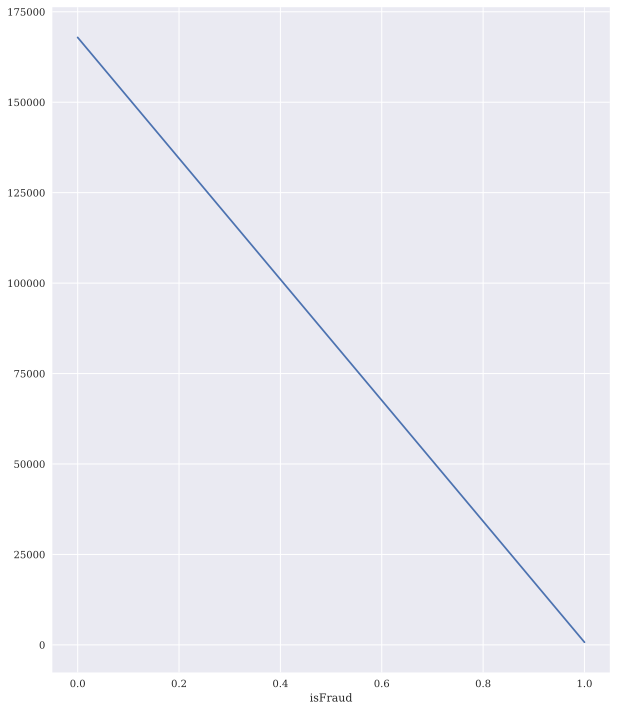

In [ ]:
d.plot(figsize=(10, 12),subplots=True);
#creating a bar plot

<ipython-input-11-e86dd7ef3d96>:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation_matrix = df2.corr()


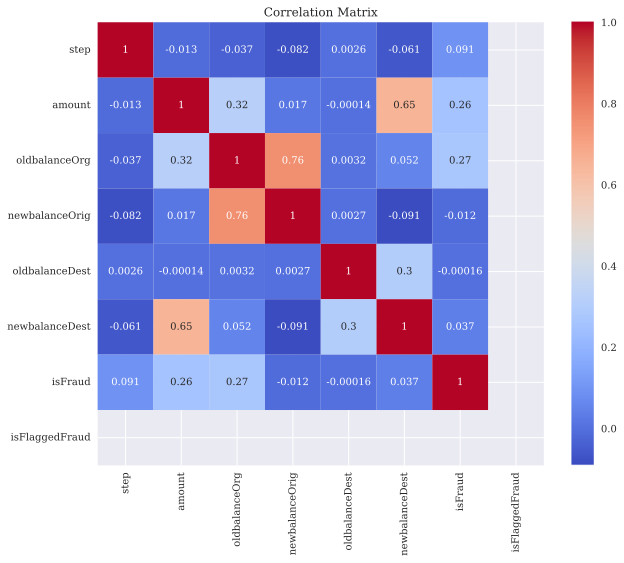

In [ ]:
#Calculate the correlation matrix
correlation_matrix = df2.corr()
# Create a new figure for the plot with the specified size
plt.figure(figsize=(10, 8))
# Create a heatmap using seaborn's heatmap function
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
# Create a heatmap using seaborn's heatmap function
plt.title('Correlation Matrix')
plt.show()

# Feature engineering

In [ ]:
# Convert the "type" column to string type and remove commas
df2.type = df2.type.astype(str).str.replace(',','')

In [ ]:
# Create the feature array (input features)
features_columns = ["type", "amount", "oldbalanceDest", "newbalanceOrig"]
x = df2[features_columns].values
# Create the target array (output labels)
y = df2["isFraud"].values

In [ ]:
#create an instance of the LableEncoder
le = LabelEncoder()
#fit the LabelEncoder to the target variable and transform it
x = le.fit_transform(df2["type"])

In [ ]:
#drop unnessary columns
df2.dropna(subset=["step", "nameOrig", "oldbalanceOrg", "newbalanceOrig", "nameDest", "isFlaggedFraud"], inplace=True)


In [ ]:
print(x)

[1 0 0 ... 2 2 1]


In [ ]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 168635 entries, 0 to 168634
Data columns (total 11 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   step            168635 non-null  int64  
 1   type            168635 non-null  object 
 2   amount          168635 non-null  float64
 3   nameOrig        168635 non-null  object 
 4   oldbalanceOrg   168635 non-null  float64
 5   newbalanceOrig  168635 non-null  float64
 6   nameDest        168635 non-null  object 
 7   oldbalanceDest  168635 non-null  float64
 8   newbalanceDest  168635 non-null  float64
 9   isFraud         168635 non-null  int64  
 10  isFlaggedFraud  168635 non-null  int64  
dtypes: float64(5), int64(3), object(3)
memory usage: 14.2+ MB


In [ ]:
#set the matplotlib backend to display plots inline
%matplotlib inline
#create a new figure
plt.figure()
#create a pairplot using seaborn
sns.pairplot(df2, hue="isFraud", height=3, markers=["o", "s"])
plt.show()

In [ ]:
# Generating a synthetic imbalanced dataset (you should replace this with your own data)
x, y = make_classification(n_classes=2, class_sep=2, weights=[0.1, 0.9], n_informative=3, n_redundant=1, flip_y=0, n_features=20, n_clusters_per_class=1, n_samples=1000, random_state=42)

# Count the number of samples in each class before oversampling
print("Before oversampling:", Counter(y))

# Applying SMOTE to oversample the minority class
smote = SMOTE(sampling_strategy='auto', random_state=42)
x_resampled, y_resampled = smote.fit_resample(x, y)

# Count the number of samples in each class after oversampling
print("After oversampling:", Counter(y_resampled))


Before oversampling: Counter({1: 900, 0: 100})
After oversampling: Counter({1: 900, 0: 900})


In [ ]:
#split the data into training and testing sets
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size = 0.4, random_state = 0)

In [ ]:
#instantiate learning model(k = 1)
classifier = KNeighborsClassifier(n_neighbors=1)

classifier.fit(x_train, y_train)

#predicting the test set results
y_pred = classifier.predict(x_test)



In [ ]:
# Assuming y_test and y_pred are 1D arrays with the true labels and predicted labels, respectively
cm = confusion_matrix(y_test, y_pred)
print(cm)

[[ 33   4]
 [  0 363]]


In [ ]:
#compute the accuracy score
accuracy = accuracy_score(y_test, y_pred) * 100
#output the accuracy score
print("Accuracy of our model is equal to " + str(round(accuracy, 2)) + "%.")

Accuracy of our model is equal to 99.0%.


<ipython-input-24-f3ac6357ec5a>:10: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(x[:, 0], x[:, 1], x[:, 2], c='blue', cmap=plt.cm.Set1, edgecolor='k')
<ipython-input-24-f3ac6357ec5a>:20: MatplotlibDeprecationWarning: The w_zaxis attribute was deprecated in Matplotlib 3.1 and will be removed in 3.8. Use zaxis instead.
  ax.w_zaxis.set_ticklabels([])


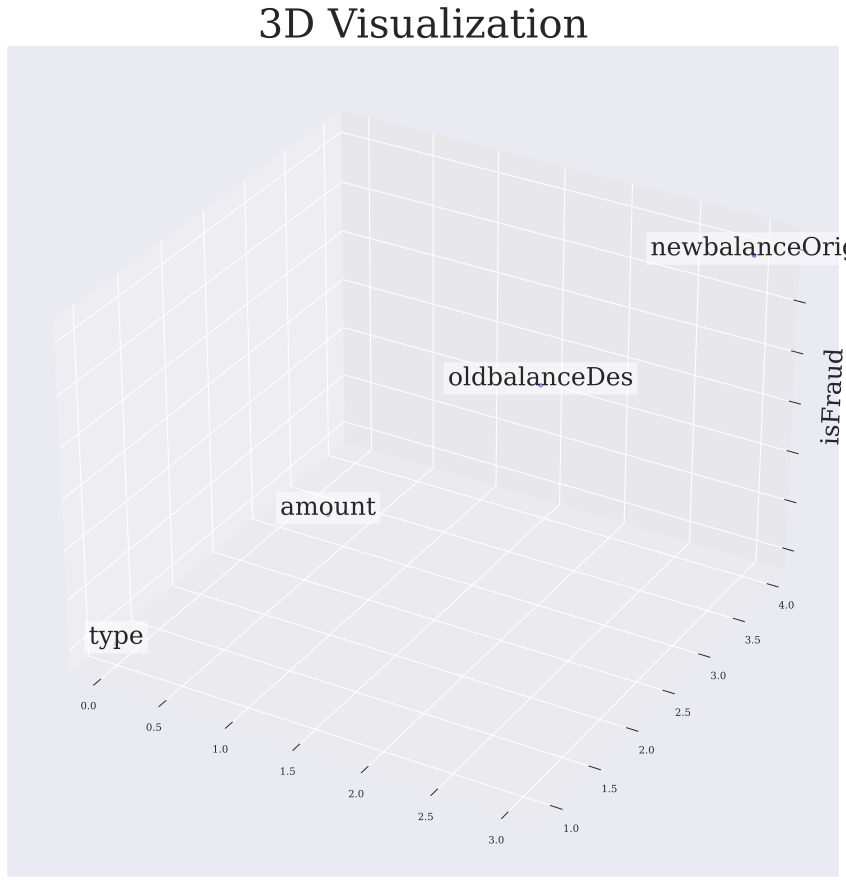

In [ ]:
# Custom data
x = np.array([[0, 1, 2, 3], [1, 2, 3, 4], [2, 3, 4, 5]]).T  # x, y, z coordinates
labels = ['type', 'amount', 'oldbalanceDes', 'newbalanceOrig']  # Labels for each data point

# Create a figure and a 3D axes object
fig = plt.figure(figsize=(20, 15))
ax = fig.add_subplot(111, projection='3d')

# Scatter plot
ax.scatter(x[:, 0], x[:, 1], x[:, 2], c='blue', cmap=plt.cm.Set1, edgecolor='k')

# Data point labels
for i, label in enumerate(labels):
    ax.text3D(x[i, 0], x[i, 1], x[i, 2], label,
              horizontalalignment='center', bbox=dict(alpha=.5, edgecolor='w', facecolor='w'), size=25)

# Set labels and title
ax.set_title("3D Visualization", fontsize=40)
ax.set_zlabel("isFraud", fontsize=25)
ax.w_zaxis.set_ticklabels([])

# Display the plot
plt.show()


# linear regression

In [ ]:
# Create a scatter plot
plt.scatter(df2["isFraud"], df2["newbalanceOrig"])
# Set the labels for the x-axis and y-axis
plt.xlabel("isFraud")
plt.ylabel("amount")
# Set the title of the plot
plt.title("isFraud vs newbalanceOrig")
# Show the plot
plt.show()

In [ ]:
# Create the training set by selecting the first 80% of rows
train = df2[:(int((len(df2)*0.8)))]
# Create the test set by selecting the first 80% of rows
test = df2[:(int((len(df2)*0.8))):]

In [ ]:
# Create a LinearRegression object
regr = linear_model.LinearRegression()
# Extract the features (isFraud) and target (amount) arrays from the train DataFrame
train_x = np.array(train[["isFraud"]])
train_y = np.array(train[["amount"]])
# Fit the linear regression model on the training data
regr.fit(train_x,train_y)
# Print the coefficients (slope) and the intercept of the linear regression model
print("coefficient : ",regr.coef_)  #slope
print("Intercept : ",regr.intercept_)

coefficient :  [[1061859.37033091]]
Intercept :  [155098.7043669]


In [ ]:
# Create a scatter plot of the training data
plt.scatter(train["isFraud"], train["amount"], color="blue")
# Plot the fitted linear regression line
plt.plot(train_x, regr.coef_*train_x + regr.intercept_, "-r")
# Set labels for the x-axis and y-axis
plt.xlabel("number of fraud")
plt.ylabel("amount")

Text(0, 0.5, 'amount')

In [ ]:
#predicting value :
#function for predicting future value :

def get_regression_predictions(input_features,intercept,slope):
  predicted_values = input_features*slope + intercept

  return predicted_values

In [ ]:
# Extract the features (isFraud) and target (amount) arrays from the test DataFrame
test_x = np.array(test[['isFraud']])
test_y = np.array(test[['amount']])
# Predict the target values (amount) using the fitted linear regression model
test_y_ = regr.predict(test_x)
# Calculate Mean Absolute Error (MAE)
print("Mean absolute error: %.2f" %np.mean(np.absolute(test_y_ - test_y)))
# Calculate Mean Squared Error (MSE)
print("Mean sum of square (MSE): %.2f" % np.mean((test_y_ - test_y) ** 2))
# Calculate R-squared (R2) score
print("R2.Score: %.2f" % r2_score(test_y_ , test_y))

Mean absolute error: 159409.13
Mean sum of square (MSE): 86960492844.88
R2.Score: -13.37
